[![Roboflow Notebooks](https://media.roboflow.com/notebooks/template/bannertest2-2.png?ik-sdk-version=javascript-1.4.3&updatedAt=1672932710194)](https://github.com/roboflow/notebooks)

# How to Train YOLOv8 Object Detection on a Custom Dataset

---

[![Roboflow](https://raw.githubusercontent.com/roboflow-ai/notebooks/main/assets/badges/roboflow-blogpost.svg)](https://blog.roboflow.com/how-to-train-yolov8-on-a-custom-dataset)
[![YouTube](https://badges.aleen42.com/src/youtube.svg)](https://youtu.be/wuZtUMEiKWY)
[![GitHub](https://badges.aleen42.com/src/github.svg)](https://github.com/ultralytics/ultralytics)

Ultralytics YOLOv8 is the latest version of the YOLO (You Only Look Once) object detection and image segmentation model developed by Ultralytics. The YOLOv8 model is designed to be fast, accurate, and easy to use, making it an excellent choice for a wide range of object detection and image segmentation tasks. It can be trained on large datasets and is capable of running on a variety of hardware platforms, from CPUs to GPUs.

## ⚠️ Disclaimer

YOLOv8 is still under heavy development. Breaking changes are being introduced almost weekly. We strive to make our YOLOv8 notebooks work with the latest version of the library. Last tests took place on **27.01.2023** with version **YOLOv8.0.20**.

If you notice that our notebook behaves incorrectly - especially if you experience errors that prevent you from going through the tutorial - don't hesitate! Let us know and open an [issue](https://github.com/roboflow/notebooks/issues) on the Roboflow Notebooks repository.

## Accompanying Blog Post

We recommend that you follow along in this notebook while reading the blog post on how to train YOLOv8 Object Detection, concurrently.

## Pro Tip: Use GPU Acceleration

If you are running this notebook in Google Colab, navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`. This will ensure your notebook uses a GPU, which will significantly speed up model training times.

## Steps in this Tutorial

In this tutorial, we are going to cover:

- Before you start
- Install YOLOv8
- CLI Basics
- Inference with Pre-trained COCO Model
- Roboflow Universe
- Preparing a custom dataset
- Custom Training
- Validate Custom Model
- Inference with Custom Model

**Let's begin!**

## Before you start

Let's make sure that we have access to GPU. We can use `nvidia-smi` command to do that. In case of any problems navigate to `Edit` -> `Notebook settings` -> `Hardware accelerator`, set it to `GPU`, and then click `Save`.

In [ ]:
!nvidia-smi

Mon Jan  8 12:55:44 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   53C    P8              11W /  70W |      3MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
#need run
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#need run, change the drive_dir to your google drive for backup
import os
import random
import glob as glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
import requests
import random
import numpy as np
import math
import tensorflow as tf
from tensorflow.keras.callbacks import TensorBoard
from datetime import datetime
import json
import shutil

np.random.seed(42)
home_dir = os.getcwd()
drive_dir = f"{home_dir}/drive/MyDrive/Colab_Notebooks/YOLOv8"

## Install YOLOv8

⚠️ YOLOv8 is still under heavy development. Breaking changes are being introduced almost weekly. We strive to make our YOLOv8 notebooks work with the latest version of the library. Last tests took place on **27.01.2023** with version **YOLOv8.0.20**.

If you notice that our notebook behaves incorrectly - especially if you experience errors that prevent you from going through the tutorial - don't hesitate! Let us know and open an [issue](https://github.com/roboflow/notebooks/issues) on the Roboflow Notebooks repository.

YOLOv8 can be installed in two ways - from the source and via pip. This is because it is the first iteration of YOLO to have an official package.

In [ ]:
# need run

# !pip install ultralytics==8.0.20
!pip install ultralytics

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

from ultralytics import YOLO

from IPython.display import display, Image

Ultralytics YOLOv8.0.237 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 26.8/78.2 GB disk)


In [ ]:
# Git clone method (for development)

# %cd {home_dir}
# !git clone github.com/ultralytics/ultralytics
# %cd {home_dir}/ultralytics
# !pip install -e .

# from IPython import display
# display.clear_output()

# import ultralytics
# ultralytics.checks()

## CLI Basics

If you want to train, validate or run inference on models and don't need to make any modifications to the code, using YOLO command line interface is the easiest way to get started. Read more about CLI in [Ultralytics YOLO Docs](https://docs.ultralytics.com/usage/cli/).

```
yolo task=detect    mode=train    model=yolov8n.yaml      args...
          classify       predict        yolov8n-cls.yaml  args...
          segment        val            yolov8n-seg.yaml  args...
                         export         yolov8n.pt        format=onnx  args...
```

## Inference with Pre-trained COCO Model

### 💻 CLI

`yolo mode=predict` runs YOLOv8 inference on a variety of sources, downloading models automatically from the latest YOLOv8 release, and saving results to `runs/predict`.

In [ ]:
# %cd {home_dir}
# !yolo task=detect mode=predict model=yolov8n.pt conf=0.25 source='https://media.roboflow.com/notebooks/examples/dog.jpeg' save=True

In [ ]:
# %cd {home_dir}
# Image(filename='runs/detect/predict/dog.jpeg', height=600)

### 🐍 Python SDK

The simplest way of simply using YOLOv8 directly in a Python environment.

In [ ]:
# model = YOLO(f'{home_dir}/yolov8n.pt')
# results = model.predict(source='https://media.roboflow.com/notebooks/examples/dog.jpeg', conf=0.25)

In [ ]:
# results[0].boxes.xyxy

In [ ]:
# results[0].boxes.conf

In [ ]:
# results[0].boxes.cls

## Roboflow Universe

Need data for your project? Before spending time on annotating, check out Roboflow Universe, a repository of more than 110,000 open-source datasets that you can use in your projects. You'll find datasets containing everything from annotated cracks in concrete to plant images with disease annotations.


[![Roboflow Universe](https://media.roboflow.com/notebooks/template/uni-banner-frame.png?ik-sdk-version=javascript-1.4.3&updatedAt=1672878480290)](https://universe.roboflow.com/)



## Preparing a custom dataset

Building a custom dataset can be a painful process. It might take dozens or even hundreds of hours to collect images, label them, and export them in the proper format. Fortunately, Roboflow makes this process as straightforward and fast as possible. Let me show you how!

### Step 1: Creating project

Before you start, you need to create a Roboflow [account](https://app.roboflow.com/login). Once you do that, you can create a new project in the Roboflow [dashboard](https://app.roboflow.com/). Keep in mind to choose the right project type. In our case, Object Detection.

<div align="center">
  <img
    width="640"
    src="https://media.roboflow.com/preparing-custom-dataset-example/creating-project.gif?ik-sdk-version=javascript-1.4.3&updatedAt=1672929799852"
  >
</div>

### Step 2: Uploading images

Next, add the data to your newly created project. You can do it via API or through our [web interface](https://docs.roboflow.com/adding-data/object-detection).

If you drag and drop a directory with a dataset in a supported format, the Roboflow dashboard will automatically read the images and annotations together.

<div align="center">
  <img
    width="640"
    src="https://media.roboflow.com/preparing-custom-dataset-example/uploading-images.gif?ik-sdk-version=javascript-1.4.3&updatedAt=1672929808290"
  >
</div>

### Step 3: Labeling

If you only have images, you can label them in [Roboflow Annotate](https://docs.roboflow.com/annotate).

<div align="center">
  <img
    width="640"
    src="https://user-images.githubusercontent.com/26109316/210901980-04861efd-dfc0-4a01-9373-13a36b5e1df4.gif"
  >
</div>

### Step 4: Generate new dataset version

Now that we have our images and annotations added, we can Generate a Dataset Version. When Generating a Version, you may elect to add preprocessing and augmentations. This step is completely optional, however, it can allow you to significantly improve the robustness of your model.

<div align="center">
  <img
    width="640"
    src="https://media.roboflow.com/preparing-custom-dataset-example/generate-new-version.gif?ik-sdk-version=javascript-1.4.3&updatedAt=1673003597834"
  >
</div>

### Step 5: Exporting dataset

Once the dataset version is generated, we have a hosted dataset we can load directly into our notebook for easy training. Click `Export` and select the `YOLO v5 PyTorch` dataset format.

<div align="center">
  <img
    width="640"
    src="https://media.roboflow.com/preparing-custom-dataset-example/export.gif?ik-sdk-version=javascript-1.4.3&updatedAt=1672943313709"
  >
</div>




In [ ]:
# # %%capture
# # !cp {drive_dir}/Products-Synth.zip  {home_dir}/data.zip
# # !unzip {home_dir}/data.zip
# # !rm {home_dir}/data.zip
# # !mv {home_dir}/Products-Synth {home_dir}/data
# import ijson

# def fix_large_json_file(json_file_path, output_file_path):
#     with open(json_file_path, 'r') as input_file, open(output_file_path, 'w') as output_file:
#         parser = ijson.parse(input_file)

#         for prefix, event, value in parser:
#             # Replace single quotes with double quotes in property names
#             if event == 'map_key':
#                 output_file.write(f'"{value}": ')
#             elif event == 'string':
#                 output_file.write(f'"{value}"')
#             elif event == 'end_map':
#                 output_file.write('\n')

# def split_and_convert_annotations(image_dir, annotations_file, output_dir, train_ratio=0.8):
#     # Create train and evaluation directories
#     train_dir = os.path.join(output_dir, 'train')
#     eval_dir = os.path.join(output_dir, 'evaluation')
#     os.makedirs(train_dir, exist_ok=True)
#     os.makedirs(eval_dir, exist_ok=True)

#     # Fix the JSON file
#     fixed_json_file = f"{output_dir}/annotations_fixed.json"
#     fix_large_json_file(annotations_file, fixed_json_file)

#     # Load annotations from the fixed JSON file
#     with open(fixed_json_file, 'r') as f:
#         annotations_data = json.load(f)

#     # Extract image filenames and annotations
#     image_filenames = list(annotations_data.keys())

#     # Shuffle the images
#     random.shuffle(image_filenames)

#     # Split images into train and evaluation sets
#     train_size = int(len(image_filenames) * train_ratio)
#     train_images = image_filenames[:train_size]
#     eval_images = image_filenames[train_size:]

#     # Write YOLOv8 format txt files for train set
#     for image_filename in train_images:
#         annotation = annotations_data[image_filename]
#         image_name = os.path.splitext(image_filename)[0]
#         txt_filename = f"{image_name}.txt"
#         txt_path = os.path.join(train_dir, txt_filename)

#         with open(txt_path, 'w') as txt_file:
#             for bbox_info in annotation['ann']:
#                 class_id = bbox_info['cls']
#                 bbox = bbox_info['bbox']
#                 x_center = (bbox[0] + bbox[2]) / (2 * annotation['width'])
#                 y_center = (bbox[1] + bbox[3]) / (2 * annotation['height'])
#                 width = (bbox[2] - bbox[0]) / annotation['width']
#                 height = (bbox[3] - bbox[1]) / annotation['height']

#                 txt_line = f"{class_id} {x_center} {y_center} {width} {height}\n"
#                 txt_file.write(txt_line)

#     # Write YOLOv8 format txt files for evaluation set
#     for image_filename in eval_images:
#         annotation = annotations_data[image_filename]
#         image_name = os.path.splitext(image_filename)[0]
#         txt_filename = f"{image_name}.txt"
#         txt_path = os.path.join(eval_dir, txt_filename)

#         with open(txt_path, 'w') as txt_file:
#             for bbox_info in annotation['ann']:
#                 class_id = bbox_info['cls']
#                 bbox = bbox_info['bbox']
#                 x_center = (bbox[0] + bbox[2]) / (2 * annotation['width'])
#                 y_center = (bbox[1] + bbox[3]) / (2 * annotation['height'])
#                 width = (bbox[2] - bbox[0]) / annotation['width']
#                 height = (bbox[3] - bbox[1]) / annotation['height']

#                 txt_line = f"{class_id} {x_center} {y_center} {width} {height}\n"
#                 txt_file.write(txt_line)

#     # Copy images to corresponding directories
#     for image_filename in train_images:
#         src_path = os.path.join(image_dir, image_filename)
#         dst_path = os.path.join(train_dir, image_filename)
#         shutil.copy(src_path, dst_path)

#     for image_filename in eval_images:
#         src_path = os.path.join(image_dir, image_filename)
#         dst_path = os.path.join(eval_dir, image_filename)
#         shutil.copy(src_path, dst_path)

# if __name__ == "__main__":
#     image_directory = "/content/data/images"
#     annotations_json = "/content/data/annotations.json"
#     output_directory = "/content/data"

#     split_and_convert_annotations(image_directory, annotations_json, output_directory)


In [ ]:
# need run
dirs = ['train', 'evaluation']

# class_names = ['exp', 'month', 'year', 'day', 'due', 'code', 'date', 'prod']
class_names = ['date']

!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="uGggphrr5ElhB32npXt6")
project = rf.workspace("kar-wai-khyar").project("exp_date2")
dataset = project.version(2).download("yolov8")


# !curl -L "https://app.roboflow.com/ds/P9fcS6dWqu?key=2GfZo11rC7" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

# !cp {drive_dir}/Products-Real.zip  {home_dir}/data.zip
# !unzip {home_dir}/data.zip -q
# !rm {home_dir}/data.zip
# !mv {home_dir}/Products-Real {home_dir}/data

# !mkdir {home_dir}/data
# %cd {home_dir}/data

# def convert_to_yolo_format(data, dir_name):
#     for image_name, image_data in data.items():
#         output_dir = f"{home_dir}/data/{dir_name}/labels"
#         os.makedirs(output_dir, exist_ok=True)
#         yolo_annotations = []
#         for annotation in image_data["ann"]:
#             if annotation["cls"] in class_names:
#                 bbox = annotation["bbox"]
#                 x_center = (bbox[0] + bbox[2]) / (2 * image_data["width"])
#                 y_center = (bbox[1] + bbox[3]) / (2 * image_data["height"])
#                 width = (bbox[2] - bbox[0]) / image_data["width"]
#                 height = (bbox[3] - bbox[1]) / image_data["height"]

#                 class_number = class_names.index(annotation['cls'])
#                 yolo_annotations.append(f"{class_number} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}")
#         with open(os.path.join(output_dir, f"{image_name.replace('.jpg', '.txt')}"), "w") as f:
#             for annotation_line in yolo_annotations:
#                 f.write(annotation_line + "\n")

# for i, dir_name in enumerate(dirs):
#     with open(f"{home_dir}/data/{dir_name}/annotations.json", "r") as json_file:
#         data = json.load(json_file)
#         convert_to_yolo_format(data, dir_name)

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.0.237, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to exp_date2-2 in yolov8:: 100%|██████████| 9282/9282 [00:02<00:00, 4090.62it/s]


In [ ]:
# need run
# colors = np.random.uniform(0, 255, size=(len(class_names), 3))
colors = [
    {"name": "Red",         "rgb": [255, 0, 0]},
    {"name": "Green",       "rgb": [0, 255, 0]},
    {"name": "Blue",        "rgb": [0, 0, 255]},
    {"name": "Yellow",      "rgb": [255, 255, 0]},
    {"name": "Magenta",     "rgb": [255, 0, 255]},
    {"name": "Cyan",        "rgb": [0, 255, 255]},
    {"name": "Purple",      "rgb": [128, 0, 128]},
    {"name": "Orange",      "rgb": [255, 165, 0]},
    {"name": "Gray",        "rgb": [128, 128, 128]},
    {"name": "Dark Green",  "rgb": [0, 128, 0]}
]

for class_name, color in zip(class_names, colors):
    color_name = color["name"]
    color_rgb = color["rgb"]
    print(f"Class: {class_name},\t Color: {color_name},\t RGB: {color_rgb}")

# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin

        class_name = class_names[int(labels[box_num])]
        color = colors[class_names.index(class_name)]["rgb"]
        color = tuple(map(int, color))

        cv2.rectangle(
            image,
            (xmin, ymin), (xmax, ymax),
            color=color,
            thickness=2
        )

        font_scale = min(0.5,max(3,int(w/500)))
        font_thickness = min(1, max(10,int(w/50)))

        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        # Text width and height
        tw, th = cv2.getTextSize(
            class_name,
            0, fontScale=font_scale, thickness=font_thickness
        )[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle(
            image,
            p1, p2,
            color=color,  # Corrected line
            thickness=-1,  # Use -1 for filling the rectangle
        )
        cv2.putText(
            image,
            class_name,
            (xmin+1, ymin-6),
            cv2.FONT_HERSHEY_SIMPLEX,
            font_scale,
            (255, 255, 255),
            font_thickness
        )
    return image

# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()

    num_images = len(all_training_images)

    plt.figure(figsize=(45, 45))
    for i in range(num_samples):
        j = random.randint(0, num_images-1)
        image_name = os.path.basename(all_training_images[j])
        image = cv2.imread(all_training_images[j])
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label = label_line[0]
                bbox_string = label_line[2:]
                x_c, y_c, w, h = bbox_string.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(3, 3, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
        plt.title(image_name, fontsize=30, pad=5)
        if i == num_samples - 1:
            h, w, _ = image.shape
            print(f"image size: {w} x {h}")
    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

Class: date,	 Color: Red,	 RGB: [255, 0, 0]


image size: 640 x 640


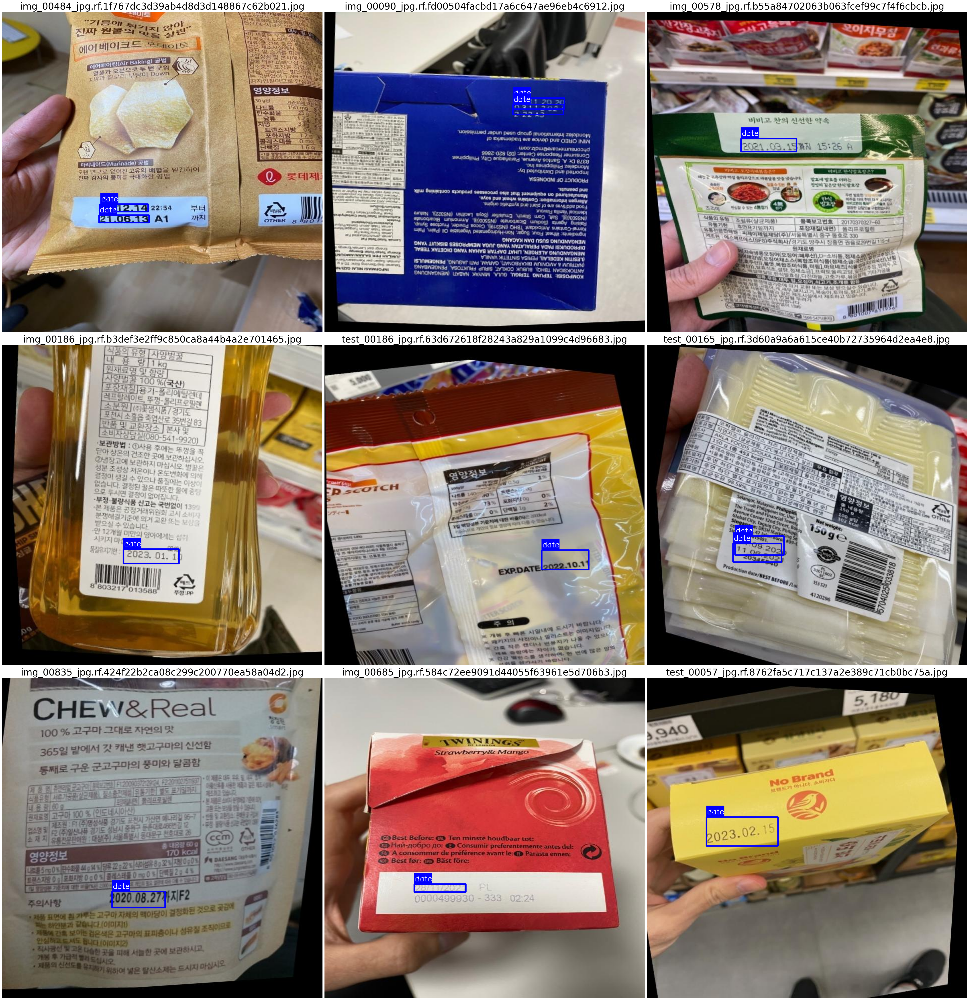

image size: 640 x 640


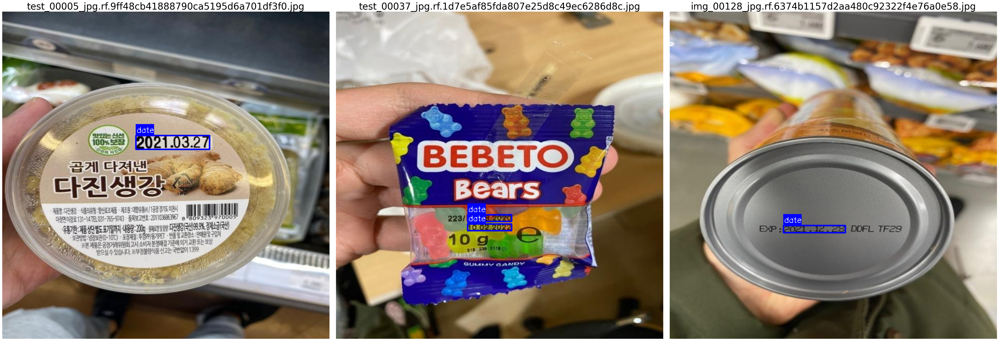

In [ ]:
# Visualize a few training images.
plot(
    # image_paths=f'{home_dir}/data/train/images/*',
    # label_paths=f'{home_dir}/data/train/labels/*',
    image_paths=f'{dataset.location}/train/images/*',
    label_paths=f'{dataset.location}/train/labels/*',
    num_samples=9
)

plot(
    # image_paths=f'{home_dir}/data/evaluation/images/*',
    # label_paths=f'{home_dir}/data/evaluation/labels/*',
    image_paths=f'{dataset.location}/valid/images/*',
    label_paths=f'{dataset.location}/valid/labels/*',
    num_samples=3
)

## Custom Training

In [ ]:
#need run
def set_res_dir():
    # Directory to store results
    res_dir_count = len(glob.glob(f'{drive_dir}/*'))
    print(f"Current number of result directories: {res_dir_count}")
    RES_DIR = f"results_{res_dir_count+1}"
    print(RES_DIR)
    return RES_DIR

def set_train_dir():
    # Directory to store results
    res_dir_count = len(glob.glob('/content/runs/detect/*'))
    print(f"Current number of result directories: {res_dir_count}")
    TRAIN_DIR = f"{RES_DIR}_{res_dir_count + 1}"
    print(TRAIN_DIR)
    return TRAIN_DIR

RES_DIR = set_res_dir()
!mkdir {drive_dir}/{RES_DIR}
# !cp {drive_dir}/data.yaml {home_dir}/data/data.yaml
!cp {drive_dir}/data.yaml {dataset.location}/data.yaml

Current number of result directories: 0
results_1
cp: cannot stat '/content/drive/MyDrive/Colab_Notebooks/YOLOv8/data.yaml': No such file or directory


In [ ]:
#need run
model_name = "yolov8s"
SIZE = 128
EPOCHS = 300
BATCH_SIZE = 32

In [ ]:
#need run
%cd {home_dir}

# load_ext tensorboard
# tensorboard --logdir ultralytics/runs  # replace with 'runs' directory
# !export CUDA_LAUNCH_BLOCKING=1
TRAIN_DIR = set_train_dir()
# !rm /content/data/train/labels.cache
# !rm /content/data/evaluation/labels.cache

#pretrained=yolov8n.pt
!yolo detect train model={model_name}.pt data={dataset.location}/data.yaml save=True \
epochs={EPOCHS} imgsz={SIZE} batch={BATCH_SIZE} seed=42 lr0=0.001 optimizer=AdamW \
plots=True name={TRAIN_DIR} patience=0

/content
Current number of result directories: 1
results_1_2
Ultralytics YOLOv8.0.237 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/exp_date2-2/data.yaml, epochs=300, time=None, patience=0, batch=32, imgsz=128, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=results_1_2, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=42, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, 

In [ ]:
#need run
import pandas as pd
import matplotlib.pyplot as plt

# Function to plot and save a graph with subplots
def plot_and_save_subplots(x_values, y_values_list, x_label, y_labels, titles, filename):
    num_subplots = len(y_values_list)

    plt.figure(plt.figure(figsize=(15, 12)))

    for i in range(num_subplots):
        plt.subplot(3, 3, i + 1)
        plt.plot(x_values, y_values_list[i], label=y_labels[i])
        plt.xlabel(x_label)
        plt.ylabel(y_labels[i])
        plt.title(titles[i])
        plt.legend()
        plt.grid()

    plt.tight_layout()
    plt.show()
    plt.savefig(filename)
    plt.close()

# Load the CSV file
df = pd.read_csv(f"/content/runs/detect/{TRAIN_DIR}/results.csv")
print(df.columns)

# Adjust column names based on the provided data
epochs = df['                  epoch']
box_loss_train = df['         train/box_loss']
obj_loss_train = df['         train/dfl_loss']
cls_loss_train = df['         train/cls_loss']
box_loss_valid = df['           val/box_loss']
obj_loss_valid = df['           val/dfl_loss']
cls_loss_valid = df['           val/cls_loss']
mAP50_train = df['       metrics/mAP50(B)']
mAP50_95_train = df['    metrics/mAP50-95(B)']

# Plot and save subplots
plot_and_save_subplots(
    epochs,
    [box_loss_train, obj_loss_train, cls_loss_train, box_loss_valid, obj_loss_valid, cls_loss_valid, mAP50_train, mAP50_95_train],
    'Epochs',
    ['Box Loss', 'Objectness Loss', 'Class Loss', 'Box Loss', 'Objectness Loss', 'Class Loss', 'mAP@0.5', 'mAP@0.5:0.95'],
    ['YOLOv8 Box Loss (Training)', 'YOLOv8 Objectness Loss (Training)', 'YOLOv8 Class Loss (Training)', \
     'YOLOv8 Box Loss (Validation)', 'YOLOv8 Objectness Loss (Validation)', 'YOLOv8 Class Loss (Validation)', \
     'YOLOv8 mAP@0.5', 'YOLOv8 mAP@0.5:0.95'],
    'subplots_train.png'
)

!cp ./subplots_train.png {drive_dir}/{RES_DIR}/train.png
!cp ./runs/detect/{TRAIN_DIR}/*.png {drive_dir}/{RES_DIR}
!cp ./runs/detect/{TRAIN_DIR}/*.jpg {drive_dir}/{RES_DIR}
!cp ./runs/detect/{TRAIN_DIR}/results.csv {drive_dir}/{RES_DIR}/results.csv
!cp ./runs/detect/{TRAIN_DIR}/weights/best.pt {drive_dir}/{RES_DIR}/{RES_DIR}.pt


FileNotFoundError: [Errno 2] No such file or directory: '/content/runs/detect/results_1_2/results.csv'

In [ ]:
image_directory = f'{home_dir}/runs/detect/{TRAIN_DIR}/'

# List all JPEG files in the directory
image_files = [f for f in os.listdir(image_directory) if f.endswith('.jpg') or f.endswith('.png')]

# Display each image
for image_file in image_files:
    print(image_file, "\n")
    display(Image(filename=os.path.join(image_directory, image_file), width=1500))
# Image(filename=f'{home_dir}/runs/detect/train8/confusion_matrix.png', width=600)
# Image(filename=f'{home_dir}/runs/detect/train/results.png', width=600)
# Image(filename=f'{home_dir}/runs/detect/train/val_batch0_pred.jpg', width=600)

## Validate Custom Model

In [ ]:
#need run
!yolo detect val model=./runs/detect/{TRAIN_DIR}/weights/best.pt data={dataset.location}/data.yaml conf=0.6 iou=0.6 \
name={RES_DIR}_eval

In [ ]:
def visualize(result_dir, number=4):
    plt.figure(figsize=(135, 135))
    image_names = glob.glob(os.path.join(result_dir, '*.jpg'))
    random.shuffle(image_names)
    for i, image_name in enumerate(image_names[:number]):
        image = mpimg.imread(image_name)
        plt.subplot(2, 2, i + 1)
        plt.imshow(image)
        plt.axis('off')
        if i == number - 1:
            break

    plt.tight_layout()
    plt.show()

visualize(f'./runs/detect/{RES_DIR}_eval/')

## Inference with Custom Model

In [ ]:
#need run
!yolo task=detect mode=predict model=./runs/detect/{TRAIN_DIR}/weights/best.pt conf=0.60 source={dataset.location}/test/images save=True conf=0.6 iou=0.6 \
name={RES_DIR}_test

**NOTE:** Let's take a look at few results.

In [ ]:
for image_path in glob.glob(f'{home_dir}/runs/detect/{RES_DIR}_test/*.jpg')[:3]:
      display(Image(filename=image_path, width=600))
      print("\n")

In [ ]:
#need run
!yolo export model=./runs/detect/{TRAIN_DIR}/weights/best.pt format=tfjs half=True imgsz={SIZE}
# !yolo export model=./runs/detect/{TRAIN_DIR}/weights/best.pt format=tflite keras=True int8=True half=True nms=True

In [ ]:
#need run
!cp ./runs/detect/{TRAIN_DIR}/weights/best_saved_model/best_float16.tflite {drive_dir}/{RES_DIR}/{RES_DIR}_f16.tflite
!cp ./runs/detect/{TRAIN_DIR}/weights/best_saved_model/best_float32.tflite {drive_dir}/{RES_DIR}/{RES_DIR}.tflite

## Deploy model on Roboflow

Once you have finished training your YOLOv8 model, you’ll have a set of trained weights ready for use. These weights will be in the `/runs/detect/train/weights/best.pt` folder of your project. You can upload your model weights to Roboflow Deploy to use your trained weights on our infinitely scalable infrastructure.

The `.deploy()` function in the [Roboflow pip package](https://docs.roboflow.com/python) now supports uploading YOLOv8 weights.

To upload model weights, add the following code to the “Inference with Custom Model” section in the aforementioned notebook:

In [ ]:
project.version(dataset.version).deploy(model_type="yolov8", model_path=f"{home_dir}/runs/detect/{TRAIN_DIR}/")

Dependency ultralytics==8.0.196 is required but found version=8.0.237, to fix: `pip install ultralytics==8.0.196`


In [ ]:
#While your deployment is processing, checkout the deployment docs to take your model to most destinations https://docs.roboflow.com/inference

In [ ]:
#Run inference on your model on a persistant, auto-scaling, cloud API

#load model
model = project.version(dataset.version).model

#choose random test set image
import os, random
test_set_loc = dataset.location + "/test/images/"
random_test_image = random.choice(os.listdir(test_set_loc))
print("running inference on " + random_test_image)

pred = model.predict(test_set_loc + random_test_image, confidence=40, overlap=30).json()
pred

# Deploy Your Model to the Edge

In addition to using the Roboflow hosted API for deployment, you can use [Roboflow Inference](https://inference.roboflow.com), an open source inference solution that has powered millions of API calls in production environments. Inference works with CPU and GPU, giving you immediate access to a range of devices, from the NVIDIA Jetson to TRT-compatible devices to ARM CPU devices.

With Roboflow Inference, you can self-host and deploy your model on-device. You can deploy applications using the [Inference Docker containers](https://inference.roboflow.com/quickstart/docker/) or the pip package.

For example, to install Inference on a device with an NVIDIA GPU, we can use:

```
docker pull roboflow/roboflow-inference-server-gpu
```

Then we can run inference via HTTP:

```python
import requests

workspace_id = ""
model_id = ""
image_url = ""
confidence = 0.75
api_key = ""

infer_payload = {
    "image": {
        "type": "url",
        "value": image_url,
    },
    "confidence": confidence,
    "iou_threshold": iou_thresh,
    "api_key": api_key,
}
res = requests.post(
    f"http://localhost:9001/{workspace_id}/{model_id}",
    json=infer_object_detection_payload,
)

predictions = res.json()
```

Above, set your Roboflow workspace ID, model ID, and API key.

- [Find your workspace and model ID](https://docs.roboflow.com/api-reference/workspace-and-project-ids?ref=blog.roboflow.com)
- [Find your API key](https://docs.roboflow.com/api-reference/authentication?ref=blog.roboflow.com#retrieve-an-api-key)

Also, set the URL of an image on which you want to run inference. This can be a local file.

_To use your YOLOv5 model commercially with Inference, you will need a Roboflow Enterprise license, through which you gain a pass-through license for using YOLOv5. An enterprise license also grants you access to features like advanced device management, multi-model containers, auto-batch inference, and more._

## 🏆 Congratulations

### Learning Resources

Roboflow has produced many resources that you may find interesting as you advance your knowledge of computer vision:

- [Roboflow Notebooks](https://github.com/roboflow/notebooks): A repository of over 20 notebooks that walk through how to train custom models with a range of model types, from YOLOv7 to SegFormer.
- [Roboflow YouTube](https://www.youtube.com/c/Roboflow): Our library of videos featuring deep dives into the latest in computer vision, detailed tutorials that accompany our notebooks, and more.
- [Roboflow Discuss](https://discuss.roboflow.com/): Have a question about how to do something on Roboflow? Ask your question on our discussion forum.
- [Roboflow Models](https://roboflow.com): Learn about state-of-the-art models and their performance. Find links and tutorials to guide your learning.

### Convert data formats

Roboflow provides free utilities to convert data between dozens of popular computer vision formats. Check out [Roboflow Formats](https://roboflow.com/formats) to find tutorials on how to convert data between formats in a few clicks.

### Connect computer vision to your project logic

[Roboflow Templates](https://roboflow.com/templates) is a public gallery of code snippets that you can use to connect computer vision to your project logic. Code snippets range from sending emails after inference to measuring object distance between detections.